In [3]:
import os
from pathlib import Path
import pandas as pd
from pandas.plotting import scatter_matrix
import numpy as np

import statsmodels.api as sm
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.dates import DateFormatter
import matplotlib.ticker as ticker
import seaborn as sns

import plotly.express as px


from sklearn.feature_selection import VarianceThreshold

from sklearn.model_selection import train_test_split
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.graphics.gofplots import ProbPlot


from mpl_toolkits.mplot3d import Axes3D
import sklearn
from sklearn import cluster
from sklearn.cluster import KMeans, MiniBatchKMeans
from kneed import KneeLocator
from sklearn.preprocessing import MinMaxScaler
from scipy.cluster.vq import kmeans
from scipy.spatial.distance import cdist,pdist
from matplotlib import cm
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering

np.random.seed(54)




In [4]:
filename = 'cleaned_bitcoin_upto_2022-08-10.csv'
crypto = 'btc'

In [5]:
df = pd.read_csv(filename).drop_duplicates(subset = 'conversation_id')
#df = df[df['neutral'] != 1]
#pd.to_datetime(df["time"],format = '%H:%M:%S')
#df = df.drop('hashtags',inplace = True, axis = 1)

df['date'] = pd.to_datetime(df['date'], errors='coerce')
df['date'] = pd.to_datetime(df['date'], format='%Y-%m-%d %H:%M:%S')
df = df.sort_values(by='date')
start = df['date'].iloc[0]
end = df['date'].iloc[-1] 
time_range = [start,end]


In [6]:
def compound_rate_func(x):
    threshold = 0.0
    
    if x < -threshold:
        return 'Negative'
        
    elif x >= -threshold and x <= threshold:
        return 'Neutral'
    
    else:
        return 'Positive'

df['compound_rate'] = df['compound'].apply(compound_rate_func)
df['percent_change'] = (df['close']-df['open'])/df['open']

scaler = MinMaxScaler()
df['compound_scaled'] = np.round((scaler.fit_transform(df[['compound']])*4)+1,0)




In [7]:
def create_spec_df(df,freq,crypto):
    df_count_col = ['tweet','nlikes','nreplies','nretweets']
    df_avg_col = ['open','close','high','low','volume','compound','compound_scaled','n_trades']

    df_counted = df[df['code'] == crypto].groupby(pd.Grouper(key='date', axis=0, freq=freq)).count()[['tweet']]
    df_counted['code'] = crypto
    df_summed = df[df['code'] == crypto].groupby(pd.Grouper(key='date', axis=0, freq=freq)).sum()[df_count_col[1:]]

    
    df_count = pd.concat([df_counted,df_summed],axis = 1)
    df_count.columns = ['nTweets','code', 'nlikes', 'nreplies', 'nretweets']





    df_averaged = df[df['code'] == crypto].groupby(pd.Grouper(key='date', axis=0, freq=freq)).mean()[df_avg_col]
    df_averaged.columns = ['open_avg','close_avg','high_avg','low_avg','volume_avg','compound_avg','compound_scaled_avg','n_trades_avg']

    


    

    df_averaged = df_averaged.reindex(['open_avg','close_avg','low_avg','high_avg',
                                             'volume_avg','n_trades_avg',
                                             'compound_avg','compound_scaled_avg']
                                            , axis=1)
    df_averaged['price_change'] = df_averaged['close_avg'] - df_averaged['open_avg']
    df_averaged['percent_change'] = 100 * df_averaged['price_change']/df_averaged['open_avg']
    
    df_averaged = df_averaged.round({"open_avg":2, "close_avg":2, "low_avg":2, "high_avg":2,'price_change':2, 'percent_change':2,'compound_scaled_avg':0})
    df_averaged['code'] = crypto


    df_ready = pd.concat([df_averaged,df_count], axis = 1)
    df_ready.reset_index(inplace = True)
    df_ready = df_ready.loc[:,~df_ready.columns.duplicated()].copy()

    return df_ready

In [8]:
df_day = create_spec_df(df,'D',crypto).reset_index()
#df_day_eth = create_spec_df(df,'D','eth')

#df_day = pd.concat([df_day_eth,df_day_btc], axis = 0).sort_values(by='date').reset_index()
#df_day = df_day.loc[:,~df_day.columns.duplicated()].copy()
if 'index' in df_day.columns:
    df_day.drop('index',inplace = True, axis = 1)



df_hour = create_spec_df(df,'H',crypto).reset_index()
#df_hour_eth = create_spec_df(df,'H','eth')

#df_hour = pd.concat([df_hour_eth,df_hour_btc], axis = 0).sort_values(by='date').reset_index()
#df_hour = df_hour.loc[:,~df_hour.columns.duplicated()].copy()
if 'index' in df_hour.columns:
    df_hour.drop('index',inplace = True, axis = 1)


df_min = create_spec_df(df,'min',crypto).reset_index()
#df_min_eth = create_spec_df(df,'min','eth')

#df_min = pd.concat([df_min_eth,df_min_btc], axis = 0).sort_values(by='date').reset_index()
#df_min = df_min.loc[:,~df_min.columns.duplicated()].copy()
if 'index' in df_min.columns:
    df_min.drop('index',inplace = True, axis = 1)

# Plotting

In [9]:
df_min

,date,open_avg,close_avg,low_avg,high_avg,volume_avg,n_trades_avg,compound_avg,compound_scaled_avg,price_change,percent_change,code,nTweets,nlikes,nreplies,nretweets
0,2022-08-01 00:00:00,23293.82,23286.04,23262.39,23300.19,1.659312e+12,4.530644e+06,0.097517,3.0,-7.78,-0.03,btc,92,655.0,250.0,141.0
1,2022-08-01 00:01:00,23292.39,23304.96,23265.66,23317.69,1.659312e+12,3.326528e+06,0.092610,3.0,12.57,0.05,btc,31,402.0,40.0,24.0
2,2022-08-01 00:02:00,23305.01,23284.10,23267.89,23306.87,1.659312e+12,2.608819e+06,0.083689,3.0,-20.91,-0.09,btc,27,25.0,2.0,1.0
3,2022-08-01 00:03:00,23282.13,23278.05,23264.53,23294.05,1.659312e+12,2.062340e+06,0.174514,3.0,-4.08,-0.02,btc,28,48.0,19.0,16.0
4,2022-08-01 00:04:00,23275.10,23272.71,23265.08,23287.80,1.659312e+12,1.632321e+06,0.022493,3.0,-2.39,-0.01,btc,29,223.0,37.0,22.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12955,2022-08-09 23:55:00,23147.52,23150.23,23138.98,23155.60,1.660089e+12,1.096914e+06,0.271174,4.0,2.71,0.01,btc,19,6.0,8.0,7.0
12956,2022-08-09 23:56:00,23149.45,23146.51,23143.84,23154.65,1.660089e+12,8.433827e+05,0.162300,3.0,-2.94,-0.01,btc,19,34.0,12.0,5.0
12957,2022-08-09 23:57:00,23146.46,23141.24,23138.26,23147.75,1.660090e+12,9.963073e+05,0.178315,3.0,-5.22,-0.02,btc,20,25.0,12.0,1.0
12958,2022-08-09 23:58:00,23142.37,23142.18,23134.09,23149.44,1.660090e+12,1.010410e+06,0.087544,3.0,-0.19,-0.00,btc,16,20.0,5.0,3.0


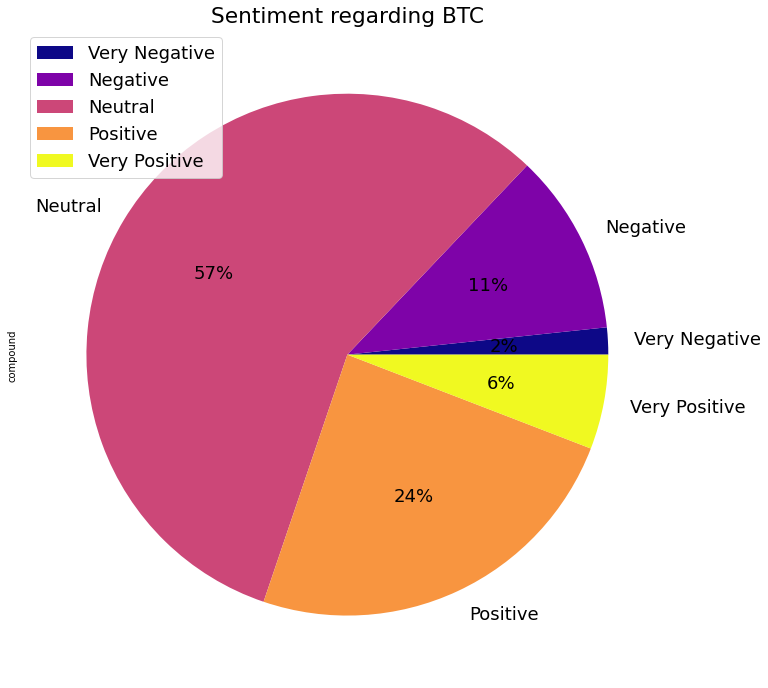

In [10]:
fig, ax = plt.subplots(nrows=1, ncols=1,figsize = (12,12))
plt.rcParams['font.size'] = 18
df_compound_scaled = df.groupby('compound_scaled').count()
df_compound_scaled.plot(kind='pie', y='compound', autopct='%1.0f%%',
                                cmap = 'plasma',
                                title='Sentiment regarding BTC', ax = ax,
                                labels = ['Very Negative','Negative','Neutral','Positive','Very Positive'])
plt.show()
plt.close()

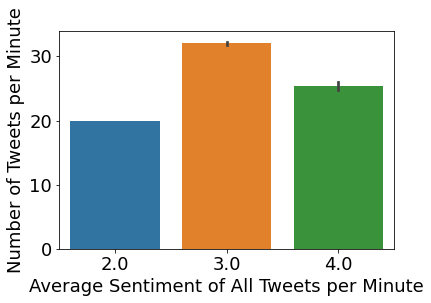

In [11]:
sns.barplot(data = df_min, x = 'compound_scaled_avg', y = 'nTweets')
plt.ylabel('Number of Tweets per Minute')
plt.xlabel('Average Sentiment of All Tweets per Minute')
plt.show()
plt.close()




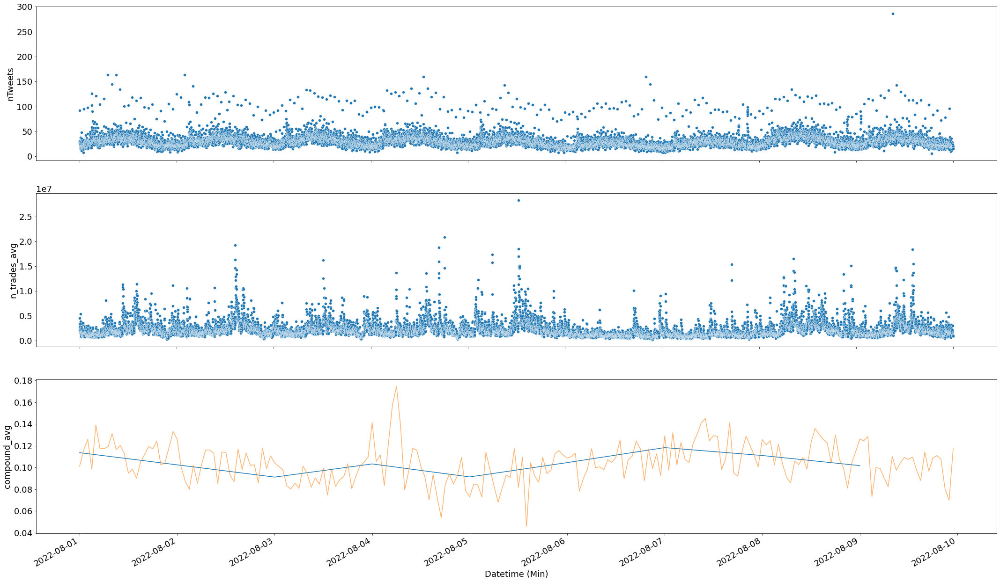

In [12]:
fig, ax = plt.subplots(nrows=3, ncols=1,figsize = (30,20))

#plt.plot()

day_line = sns.lineplot(data = df_day ,x = 'date', y = 'compound_avg', ax = ax[2], alpha = 1)
hour_line = sns.lineplot(data = df_hour ,x = 'date', y = 'compound_avg', ax = ax[2], alpha = 0.6, legend = False)
sns.scatterplot(data = df_min, x = 'date', y = 'nTweets', ax = ax[0])
sns.scatterplot(data = df_min, x = 'date', y = 'n_trades_avg', ax = ax[1])



plt.xlabel('Datetime (Min)')
fig.tight_layout()
fig.autofmt_xdate()

plt.show()


In [13]:
df_sec_tweet = df.groupby(pd.Grouper(key='date', axis=0, freq='s')).count()[['tweet']]
df_sec_compound = df.groupby(pd.Grouper(key='date', axis=0, freq='s')).mean()[['compound_scaled','n_trades']]
df_sec = pd.concat([df_sec_tweet,df_sec_compound],axis = 1)

df_sec = df_sec.round({'compound_scaled':0})


In [15]:
hist_fig = px.bar(df_sec, y = 'tweet', x = 'compound_scaled',
             height = 800, width = 1000,
             title = f'Number of Trades of Each {crypto} in a 9 day Window (1-Aug-22 up until 10-Aug-22)', 
             labels={'percent_change':'Percent Change', 
                     'code': 'Cryptocurrency',
                    'tweet':'Number of Tweets per second',
                    'compound_scaled':'Sentiment'}) 
hist_fig.show()

In [1]:
fig, ax2 = plt.subplots(figsize=(30,15))
plt.axhline(y=0, color='black', linestyle='-', linewidth = 4)

sns.set_palette("tab10")

sns.lineplot(data = df_min, x='date', y='percent_change', alpha=0.4, ax= ax2)
sns.scatterplot(data = df_min, x='date', y='nTweets', hue = 'compound_scaled_avg', alpha=0.3, ax= ax2.twinx())

fig.autofmt_xdate()



plt.show()

NameError: name 'plt' is not defined

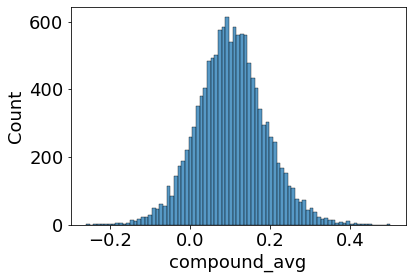

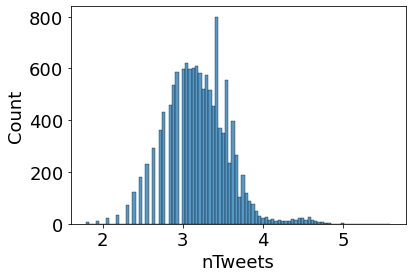

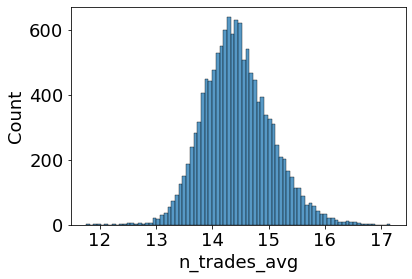

In [15]:
#for col in df_counted_hour:

sns.histplot(data = df_min_btc, x = 'compound_avg')
plt.show()
plt.close()
sns.histplot(data = df_min_btc, x = np.log1p((df_min_btc['nTweets'])))
plt.show()
plt.close()
sns.histplot(data = df_min_btc, x = np.log1p((df_min_btc['n_trades_avg'])))
plt.show()
plt.close()


# Regression Modeling

In [ ]:
plt.rcParams['font.size'] = 14

In [56]:
from unicodedata import name


def regression_model(df,predictor_list,target,model = 'linear'):
    columns = []
    if len(predictor_list) > 1:
        for x in predictor_list:
            columns.append(x)
        columns.append(target)
    
    if(model == 'linear'):
        columns = []
        columns.append(predictor_list[0])
        columns.append(target)


        #fig, ax = plt.subplots(nrows = 3, ncols = 1, figsize = (15,10))
        #ax[1].hist(df[predictor_list[0]])
        #plt.xlabel(predictor_list[0])
        #plt.ylabel('Frequency')

        #ax[2].hist(df[target])
        #plt.xlabel(target)
        #plt.ylabel('Frequency')


        #ax[0].scatter(df[predictor_list[0]],df[target])
        #plt.xlabel(predictor_list[0])
        #plt.ylabel(target)

        #plt.show()
        #plt.close()

    model_df = df.copy()[columns]
    
    selector = VarianceThreshold()
    model_df_c = pd.DataFrame(selector.fit_transform(model_df[columns]), columns = columns)
    print(model_df.head())
    print(model_df_c.head())


In [58]:
regression_model(df_min_btc,['nTweets','n_trades_avg','compound_avg','volume_avg'],'high_avg','multiple')

   nTweets  n_trades_avg  compound_avg    volume_avg  high_avg
0       80  4.531261e+06      0.094887  1.659312e+12  23300.18
1       26  3.338261e+06      0.083577  1.659312e+12  23317.69
2       20  2.589597e+06      0.057570  1.659312e+12  23305.73
3       25  2.028855e+06      0.196488  1.659312e+12  23294.41
4       23  1.622300e+06     -0.007422  1.659312e+12  23286.90
   nTweets  n_trades_avg  compound_avg    volume_avg  high_avg
0     80.0  4.531261e+06      0.094887  1.659312e+12  23300.18
1     26.0  3.338261e+06      0.083577  1.659312e+12  23317.69
2     20.0  2.589597e+06      0.057570  1.659312e+12  23305.73
3     25.0  2.028855e+06      0.196488  1.659312e+12  23294.41
4     23.0  1.622300e+06     -0.007422  1.659312e+12  23286.90


### RMSE function

In [ ]:
def rmse(predictions,actual):
    return np.sqrt(((predictions-actual) ** 2).mean())



In [1]:
df_min.columns

NameError: name 'df_min' is not defined

In [ ]:
df_min_btc.corr().style.background_gradient()

## Simple Linear

In [ ]:
target = 'high_avg'
predictor = 'nTweets'
regression_btc_lr = df_min_btc[[target,predictor]]
regression_btc_lr

In [ ]:
fig, ax = plt.subplots(nrows = 3, ncols = 1, figsize = (15,10))



ax[1].hist(regression_btc_lr[predictor])
plt.xlabel(predictor)
plt.ylabel('Frequency')

ax[2].hist(regression_btc_lr[target])
plt.xlabel(target)

ax[0].scatter(regression_btc_lr[predictor],regression_btc_lr[target])
plt.xlabel(predictor)
plt.ylabel(target)

plt.show()
plt.close()

In [ ]:
selector = VarianceThreshold()
regression_btc_lr_c = selector.fit_transform(regression_btc_lr)
print(regression_btc_lr)
print(regression_btc_lr_c)

In [ ]:
Y = pd.DataFrame(regression_btc_lr[target])
X = pd.DataFrame(regression_btc_lr[predictor])
X = sm.add_constant(X)

model = sm.OLS(Y, X).fit()
(model.summary())

In [ ]:
fig = sm.graphics.abline_plot(model_results = model)
ax = fig.axes[0]

plt.scatter(X[predictor],Y[target], color = 'yellow', alpha = 0.4, edgecolor = 'black')
plt.show()
plt.close()





In [ ]:
#residual standard error of the model
print(f'residual standard error of the model: \t{np.sqrt(model.scale)}')
print(f'r-squared of the model:\t\t    \t {(model.rsquared)}')



In [ ]:
x_fit = model.fittedvalues
residuals = model.resid

In [ ]:
resid_plot = sns.residplot(x = x_fit, y = residuals, 
                    data=regression_btc_lr, 
                    lowess = True, 
                    scatter_kws = {'alpha': 0.3},
                    line_kws = {'color': 'red', 'lw': 1, 'alpha': 0.9})

#sns.scatterplot(x = ex_fitted, y = ex_residuals)
plt.xlabel('fitted values')
plt.ylabel('residuals')
resid_plot.set(title = 'Residuals of high average BTC price based on number of related tweets')

In [ ]:
#checking to see if residuals are normally distributed
model_norm_residuals = model.get_influence().resid_studentized_internal
QQ = ProbPlot(model_norm_residuals)
plot_lm_2 = QQ.qqplot(line= 's', alpha = 0.5, lw = 1)

plt.show()
plt.close()

In [ ]:
# checking if residuals have equal variance
model_norm_residuals_abs_sqrt = np.sqrt(np.abs(model_norm_residuals))

plt.scatter(x= x_fit, y = model_norm_residuals_abs_sqrt, alpha = 0.2)

sns.regplot(x = x_fit, y = model_norm_residuals_abs_sqrt,
            scatter = False, 
            ci = False, 
            lowess = True,
            line_kws = {'color': 'red', 'lw': 1, 'alpha': 1})
plt.show()
plt.close()

In [ ]:
test = model.outlier_test(method='bonf', alpha=0.05)

print(test)

print(regression_btc_lr.shape)
bonf_p_col = test['bonf(p)']
test_cut = test[bonf_p_col < 0.05]
print(test_cut)
drop_outliers = regression_btc_lr.drop(test_cut.index)
print(drop_outliers.shape)

In [ ]:
X2 = drop_outliers[predictor]
Y2 = drop_outliers[target]

X2 = sm.add_constant(X2)

model_2 = sm.OLS(Y2,X2).fit()
print(model_2.summary())

In [ ]:
model_norm_residuals = model_2.get_influence().resid_studentized_internal
QQ = ProbPlot(model_norm_residuals)
plot_lm_2 = QQ.qqplot(line= 's', alpha = 0.5, lw = 1)



In [ ]:
x_fit_2 = model_2.fittedvalues
sns.residplot(x = x_fit_2, y = model_2.resid, 
                    data=regression_btc_lr, 
                    lowess = True, 
                    scatter_kws = {'alpha': 0.3},
                    line_kws = {'color': 'red', 'lw': 1, 'alpha': 0.9})
plt.show()
plt.close()

## Multiple Linear

In [ ]:
target = 'high_avg'
predictors = ['nTweets','percent_change','compound_avg']
col = ['nTweets','percent_change','compound_avg','high_avg']

In [ ]:
regression_btc_ml = df_min_btc[col]
regression_btc_ml

In [ ]:
ax = scatter_matrix(regression_btc_ml,figsize=(15, 15), diagonal='kde')

plt.show()
plt.close()

In [ ]:
selector = VarianceThreshold()
regression_btc_ml_c = selector.fit_transform(regression_btc_ml)
print(regression_btc_ml.shape)
print(regression_btc_ml_c.shape)

In [ ]:
X = regression_btc_ml[predictors]
X = sm.add_constant(X)
Y = regression_btc_ml[target]

In [ ]:
np.random.seed(54)
x_train_ml, x_test_ml, y_train_ml, y_test_ml = train_test_split(X, Y, test_size = 0.3)
print(x_train_ml.shape)
print(y_train_ml.shape)


print(x_test_ml.shape)
print(y_test_ml.shape)



In [ ]:
model = sm.OLS(y_train_ml,x_train_ml).fit()
(model.summary())

In [ ]:
fitted = model.fittedvalues
residuals = model.resid

model_norm_residuals = model.get_influence().resid_studentized_internal

#print(ex_model_m_norm_residuals)
model_norm_residuals_abs_sqrt = np.sqrt(np.abs(model_norm_residuals))
#print(ex_model_m_norm_residuals_abs_sqrt)

model_m_abs_resid = np.abs(residuals)

training_data = pd.concat([x_train_ml,y_train_ml], axis = 1)



In [ ]:
sns.residplot(x=fitted, y=residuals, data = training_data, 
                          lowess = True, 
                          scatter_kws = {'alpha': 0.5}, 
                          line_kws = {'color': 'red', 'lw': 1, 'alpha': 0.8})
plt.show()
plt.close()


QQ = ProbPlot(model_norm_residuals)
QQ.qqplot(line = 's', alpha = 0.5, lw = 1)
plt.show()
plt.close()


In [ ]:
test_outlier = model.outlier_test()
print(test_outlier)

filtered_out_outliers_test_index = test_outlier[test_outlier['bonf(p)']<0.05].index

print(test_outlier.shape)
print(filtered_out_outliers_test_index)

In [ ]:
x_train_ml_no_outliers = x_train_ml.drop(filtered_out_outliers_test_index)
y_train_ml_no_outliers = y_train_ml.drop(filtered_out_outliers_test_index)

y = y_train_ml_no_outliers
x = x_train_ml_no_outliers
model_no_outliers = sm.OLS(y,x).fit()

In [ ]:
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(x.values, i) for i in range(x.shape[1])]
vif["features"] = x.columns
print(vif)




In [ ]:
y_pred = np.array(model_no_outliers.predict(x_test_ml))
actual = np.array(y_test_ml)

residuals = y_pred-actual
results = pd.DataFrame({'actual':actual, 'predicted':y_pred,'residuals':residuals})

rmse_ml =  rmse(y_pred,actual)

In [ ]:
rmse_ml

## LogLin

In [ ]:
target = 'high_avg'
predictor = 'nTweets'
predictors = ['nTweets','percent_change','compound_avg']
col = ['nTweets','percent_change','compound_avg','high_avg']
regression_btc_loglin = df_min_btc[col].copy()
regression_btc_loglin['log_high_avg'] = np.log1p(regression_btc_loglin['high_avg'])

In [ ]:
ax = scatter_matrix(regression_btc_loglin,figsize=(15, 15), diagonal='kde')

plt.show()
plt.close()

In [ ]:
selector = VarianceThreshold()
regression_btc_loglin_c = selector.fit_transform(regression_btc_loglin)
print(regression_btc_loglin.shape)
print(regression_btc_loglin_c.shape)

In [ ]:
regression_btc_loglin[predictors]
X = sm.add_constant(X)
Y = regression_btc_loglin['log_high_avg']


In [ ]:
np.random.seed(54)
x_train_loglin, x_test_loglin, y_train_loglin, y_test_loglin = train_test_split(X, Y, test_size = 0.3)
print(x_train_loglin.shape)
print(y_train_loglin.shape)


print(x_test_loglin.shape)
print(y_test_loglin.shape)




In [ ]:
model = sm.OLS(y_train_loglin,x_train_loglin).fit()
(model.summary())

In [ ]:
x_fitted = model.fittedvalues
residuals = model.resid

model_norm_residuals = model.get_influence().resid_studentized_internal

#print(ex_model_m_norm_residuals)
model_norm_residuals_abs_sqrt = np.sqrt(np.abs(model_norm_residuals))
#print(ex_model_m_norm_residuals_abs_sqrt)

model_m_abs_resid = np.abs(residuals)

training_data = pd.concat([x_train_loglin,y_train_loglin], axis = 1)




In [ ]:
sns.residplot(x=x_fitted, y='log_high_avg', data = training_data, 
                          lowess = True, 
                          scatter_kws = {'alpha': 0.5}, 
                          line_kws = {'color': 'red', 'lw': 1, 'alpha': 0.8})
plt.show()
plt.close()


QQ = ProbPlot(model_norm_residuals)
QQ.qqplot(line = 's', alpha = 0.5, lw = 1)
plt.show()
plt.close()



In [ ]:
plt.scatter(x_fitted, model_norm_residuals_abs_sqrt, alpha = 0.5)
sns.regplot(x=x_fitted, y=model_norm_residuals_abs_sqrt, 
            scatter = False, 
            ci = False, 
            lowess = True,
            line_kws = {'color': 'red', 'lw': 1, 'alpha': 0.8})
plt.show()
plt.close()

In [ ]:
test = model.outlier_test()
print('Bad data points (bonf(p) < 0.05):\n', test[test['bonf(p)'] < 0.05])

test_f = test[test['bonf(p)'] < 0.05]


x_train_loglin_no_outliers = x_train_loglin.drop(test_f.index)
y_train_loglin_no_outliers = y_train_loglin.drop(test_f.index)

# Look at the shape of the new DataFrame, notice the rows have actually been dropped.
print(x_train_loglin_no_outliers.shape)

print(y_train_loglin_no_outliers.shape)



In [ ]:
model_no_outliers = sm.OLS(y_train_loglin_no_outliers, x_train_loglin_no_outliers).fit()
model_no_outliers.summary()


In [ ]:
fitted_values_no_outliers = model_no_outliers.fittedvalues
print(fitted_values_no_outliers.head())

residuals_no_outliers = model_no_outliers.resid
print(residuals_no_outliers.head())


In [ ]:
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(x_train_loglin_no_outliers.values, i) for i in range(x_train_loglin_no_outliers.shape[1])]
vif["features"] = x_train_loglin_no_outliers.columns
print(vif)


In [ ]:
y_pred = model_no_outliers.predict(x_test_loglin)
model_no_outliers.params
sm.graphics.plot_fit(model_no_outliers,1, vlines=False)
plt.show()
plt.close()

In [ ]:
for col in x_test_loglin:
    if col != 'const':
        line = sns.lineplot(x = (x_test_loglin[col]), y = np.expm1(y_pred), color = 'red', linewidth = 3)
        scatter = sns.scatterplot(x = (x_test_loglin[col]), y = np.expm1(y_test_loglin), alpha = 0.7)
        
        scatter.set(xlabel = col,ylabel = 'high_avg')
        plt.show()
        plt.close()

In [ ]:
y_pred = np.array(model_no_outliers.predict(x_test_loglin))
actual = np.array(y_test_loglin)

residuals = y_pred-actual
results = pd.DataFrame({'actual':actual, 'predicted':y_pred,'residuals':residuals})

rmse_loglin = rmse(y_pred,actual)
rmse_loglin

## LogLog

In [ ]:
target = 'high_avg'
predictor = 'nTweets'
predictors = ['nTweets','percent_change','compound_avg']
log_predictors = ['log_nTweets','log_percent_change','log_compound_avg']
col = ['nTweets','percent_change','compound_avg','high_avg']
regression_btc_loglog = df_min_btc[col].copy()
regression_btc_loglog['log_high_avg'] = np.log1p(regression_btc_loglog['high_avg'])
regression_btc_loglog['log_nTweets'] = np.log1p(regression_btc_loglog['nTweets'])
regression_btc_loglog['log_percent_change'] = np.log1p(regression_btc_loglog['percent_change'])
regression_btc_loglog['log_compound_avg'] = np.log1p(regression_btc_loglog['compound_avg'])


regression_btc_loglog

In [ ]:
ax = scatter_matrix(regression_btc_loglog,figsize=(15, 15), diagonal='kde')

plt.show()
plt.close()

In [ ]:
selector = VarianceThreshold()
regression_btc_loglog_c = selector.fit_transform(regression_btc_loglog)
print(regression_btc_loglog.shape)
print(regression_btc_loglog_c.shape)

In [ ]:
X = regression_btc_loglog[log_predictors]
X = sm.add_constant(X)
Y = regression_btc_loglog['log_high_avg']

In [ ]:
np.random.seed(54)
x_train_loglog, x_test_loglog, y_train_loglog, y_test_loglog = train_test_split(X, Y, test_size = 0.3)
print(x_train_loglog.shape)
print(y_train_loglog.shape)


print(x_test_loglog.shape)
print(y_test_loglog.shape)

model = sm.OLS(y_train_loglog,x_train_loglog).fit()
(model.summary())

In [ ]:
x_fitted = model.fittedvalues
residuals = model.resid

model_norm_residuals = model.get_influence().resid_studentized_internal

#print(ex_model_m_norm_residuals)
model_norm_residuals_abs_sqrt = np.sqrt(np.abs(model_norm_residuals))
#print(ex_model_m_norm_residuals_abs_sqrt)

model_m_abs_resid = np.abs(residuals)

training_data = pd.concat([x_train_loglog,y_train_loglog], axis = 1)



In [ ]:
sns.residplot(x=x_fitted, y='log_high_avg', data = training_data, 
                          lowess = True, 
                          scatter_kws = {'alpha': 0.5}, 
                          line_kws = {'color': 'red', 'lw': 1, 'alpha': 0.8})
plt.show()
plt.close()


QQ = ProbPlot(model_norm_residuals)
QQ.qqplot(line = 's', alpha = 0.5, lw = 1)
plt.show()
plt.close()





In [ ]:
plt.scatter(x_fitted, model_norm_residuals_abs_sqrt, alpha = 0.5)
sns.regplot(x=x_fitted, y=model_norm_residuals_abs_sqrt, 
            scatter = False, 
            ci = False, 
            lowess = True,
            line_kws = {'color': 'red', 'lw': 1, 'alpha': 0.8})
plt.show()
plt.close()
test = model.outlier_test()
print('Bad data points (bonf(p) < 0.05):\n', test[test['bonf(p)'] < 0.05])



In [ ]:
test_f = test[test['bonf(p)'] < 0.05]


x_train_loglog_no_outliers = x_train_loglog.drop(test_f.index)
y_train_loglog_no_outliers = y_train_loglog.drop(test_f.index)

# Look at the shape of the new DataFrame, notice the rows have actually been dropped.
print(x_train_loglog_no_outliers.shape)

print(y_train_loglog_no_outliers.shape)


In [ ]:
model_no_outliers = sm.OLS(y_train_loglog_no_outliers, x_train_loglog_no_outliers).fit()
model_no_outliers.summary()

In [ ]:
fitted_values_no_outliers = model_no_outliers.fittedvalues
print(fitted_values_no_outliers.head())

residuals_no_outliers = model_no_outliers.resid
print(residuals_no_outliers.head())


In [ ]:
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(x_train_loglog_no_outliers.values, i) for i in range(x_train_loglog_no_outliers.shape[1])]
vif["features"] = x_train_loglog_no_outliers.columns
print(vif)


In [ ]:
y_pred = np.array(model_no_outliers.predict(x_test_loglog))
actual = np.array(y_test_loglog)

residuals = y_pred-actual
results = pd.DataFrame({'actual':actual, 'predicted':y_pred,'residuals':residuals})

In [ ]:
y_pred = model_no_outliers.predict(x_test_loglog)
model_no_outliers.params
sm.graphics.plot_fit(model_no_outliers,1, vlines=False)
plt.show()
plt.close()

In [ ]:
for col in x_test_loglog:
    if col != 'const':
        scatter = sns.scatterplot(x = np.expm1(x_test_loglog[col]), y = np.expm1(y_test_loglog), alpha = 0.7)
        line = sns.scatterplot(x = np.expm1(x_test_loglog[col]), y = np.expm1(y_pred), color = 'red', linewidth = 0)


        
        scatter.set(xlabel = col[4:],ylabel = 'high_avg')
        plt.show()
        plt.close()


In [ ]:
rmse_loglog = rmse(y_pred,actual)
rmse_loglin

## Interaction

In [ ]:
target = 'high_avg'
predictor = 'nTweets'
predictors = ['nTweets','percent_change','compound_avg','nTweets:percent_change','nTweets:compound_avg','percent_change:compound_avg','nTweets:percent_change:compound_avg']
col = ['nTweets','percent_change','compound_avg','high_avg']
regression_btc_interaction = df_min_btc[col].copy()

regression_btc_interaction['nTweets:percent_change'] = regression_btc_interaction['nTweets'] * regression_btc_interaction['percent_change'] 
regression_btc_interaction['nTweets:compound_avg'] = regression_btc_interaction['nTweets'] * regression_btc_interaction['compound_avg'] 
regression_btc_interaction['percent_change:compound_avg'] = regression_btc_interaction['percent_change'] * regression_btc_interaction['compound_avg'] 
regression_btc_interaction['nTweets:percent_change:compound_avg'] = regression_btc_interaction['nTweets:percent_change'] * regression_btc_interaction['compound_avg']


In [ ]:
ax = scatter_matrix(regression_btc_interaction,figsize=(30, 30), diagonal='kde')

plt.show()
plt.close()

In [ ]:
selector = VarianceThreshold()
regression_btc_interaction_c = selector.fit_transform(regression_btc_interaction)
print(regression_btc_interaction.shape)
print(regression_btc_interaction_c.shape)

In [ ]:
X = regression_btc_interaction[predictors]
X = sm.add_constant(X)
Y = regression_btc_interaction['high_avg']


In [ ]:
np.random.seed(54)
x_train_interaction, x_test_interaction, y_train_interaction, y_test_interaction = train_test_split(X, Y, test_size = 0.3)
print(x_train_interaction.shape)
print(y_train_interaction.shape)


print(x_test_interaction.shape)
print(y_test_interaction.shape)


In [ ]:
model = sm.OLS(y_train_interaction,x_train_interaction).fit()
(model.summary())

In [ ]:
x_fitted = model.fittedvalues
residuals = model.resid

model_norm_residuals = model.get_influence().resid_studentized_internal

#print(ex_model_m_norm_residuals)
model_norm_residuals_abs_sqrt = np.sqrt(np.abs(model_norm_residuals))
#print(ex_model_m_norm_residuals_abs_sqrt)

model_m_abs_resid = np.abs(residuals)

training_data = pd.concat([x_train_interaction,y_train_interaction], axis = 1)

In [ ]:
sns.residplot(x=x_fitted, y='high_avg', data = training_data, 
                          lowess = True, 
                          scatter_kws = {'alpha': 0.5}, 
                          line_kws = {'color': 'red', 'lw': 1, 'alpha': 0.8})
plt.show()
plt.close()


In [ ]:
QQ = ProbPlot(model_norm_residuals)
QQ.qqplot(line = 's', alpha = 0.5, lw = 1)
plt.show()
plt.close()

In [ ]:
plt.scatter(x_fitted, model_norm_residuals_abs_sqrt, alpha = 0.5)
sns.regplot(x=x_fitted, y=model_norm_residuals_abs_sqrt, 
            scatter = False, 
            ci = False, 
            lowess = True,
            line_kws = {'color': 'red', 'lw': 1, 'alpha': 0.8})
plt.show()
plt.close()

In [ ]:
test = model.outlier_test()
print('Bad data points (bonf(p) < 0.05):\n', test[test['bonf(p)'] < 0.05])

test_f = test[test['bonf(p)'] < 0.05]


x_train_interaction_no_outliers = x_train_interaction.drop(test_f.index)
y_train_interaction_no_outliers = y_train_interaction.drop(test_f.index)

# Look at the shape of the new DataFrame, notice the rows have actually been dropped.
print(x_train_interaction_no_outliers.shape)

print(y_train_interaction_no_outliers.shape)

In [ ]:
model_no_outliers = sm.OLS(y_train_interaction_no_outliers, x_train_interaction_no_outliers).fit()
model_no_outliers.summary()

In [ ]:
fitted_values_no_outliers = model_no_outliers.fittedvalues
print(fitted_values_no_outliers.head())

residuals_no_outliers = model_no_outliers.resid
print(residuals_no_outliers.head())



In [ ]:
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(x_train_interaction_no_outliers.values, i) for i in range(x_train_interaction_no_outliers.shape[1])]
vif["features"] = x_train_interaction_no_outliers.columns
print(vif)



In [ ]:
y_pred = model_no_outliers.predict(x_test_interaction)
model_no_outliers.params
sm.graphics.plot_fit(model_no_outliers,1, vlines=False)
plt.show()
plt.close()


In [ ]:
for col in x_test_interaction:
    if col != 'const':
        scatter = sns.scatterplot(x = (x_test_interaction[col]), y = (y_test_interaction), alpha = 0.7, edgecolor = 'black')
        line = sns.scatterplot(x = (x_test_interaction[col]), y = (y_pred), color = 'r', linewidth = 0)


        
        scatter.set(xlabel = col,ylabel = 'high_avg')
        plt.show()
        plt.close()

In [ ]:
y_pred

In [ ]:
y_pred = np.array(model_no_outliers.predict(x_test_interaction))
actual = np.array(y_test_interaction)
residuals = y_pred-actual
results = pd.DataFrame({'actual':actual, 'predicted':y_pred,'residuals':residuals})

In [ ]:
rmse_int = rmse(y_pred,actual)
rmse_int

# Clustering

## K-Means

In [ ]:
df_min_btc

In [ ]:
columns = ['date','nTweets', 'percent_change', 'compound_avg','high_avg']

In [ ]:
cluster_df_min_btc = df_min_btc.copy()
cluster_df_hour_btc = df_hour_btc.copy()


k_df_min = cluster_df_min_btc.reset_index()[columns]
k_df_hour = cluster_df_hour_btc.reset_index()[columns]

In [ ]:
fig = px.scatter_matrix(k_df_min, width = 1000, height = 1000, opacity = 0.4)
for t in fig.data:
    t.marker.line.width = 0.5
    t.marker.line.color = "black"

fig.show()


In [ ]:
fig1 = px.scatter(k_df_min, size = 'nTweets', color = 'compound_avg', y = 'percent_change', x = 'date', height = 750)
fig1.show()

In [ ]:
fig1 = px.scatter(k_df_hour, size = 'nTweets', color = 'compound_avg', y = 'percent_change', x = 'date', height = 750)
fig1.show()

In [ ]:
fig1 = px.scatter_3d(k_df_hour, size = 'nTweets', color = 'compound_avg', y = 'percent_change', x = 'date', z = 'high_avg',height = 750, width = 750)
for t in fig.data:
    t.marker.line.width = 0.5
    t.marker.line.color = "black"
fig1.show()

In [ ]:
k_df_min.drop('date',inplace = True, axis = 1)
scaler = MinMaxScaler()
k_df_min_scaled = scaler.fit_transform(k_df_min)
df_kmeans_min = pd.DataFrame(k_df_min_scaled, columns = k_df_min.columns)
(df_kmeans_min.head())

In [ ]:
kmeans_default = KMeans(n_clusters=2)
kmeans_default = kmeans_default.fit(df_kmeans_min)
ex_labels = kmeans_default.predict(df_kmeans_min)
C_default = kmeans_default.cluster_centers_

x = 3
y = 2

plt.scatter(df_kmeans_min.iloc[:,x],
            df_kmeans_min.iloc[:,y],
            c=kmeans_default.labels_,
            cmap='Set2',alpha = 0.3,edgecolors = 'black')

plt.scatter(C_default[:, x],
            C_default[:, y],
            c='black', edgecolors = 'white',
            s=200,
            alpha=0.7)

plt.xlabel(df_kmeans_min.columns[x])
plt.ylabel(df_kmeans_min.columns[y])



plt.show()
plt.close()


In [ ]:
kmeans_default = KMeans(n_clusters=2)
kmeans_default = kmeans_default.fit(df_kmeans_min)
ex_labels = kmeans_default.predict(df_kmeans_min)
C_default = kmeans_default.cluster_centers_

x = 0
y = 1

plt.scatter(df_kmeans_min.iloc[:,x],
            df_kmeans_min.iloc[:,y],
            c=kmeans_default.labels_,
            cmap='Set2',alpha = 0.3,edgecolors = 'black')

plt.scatter(C_default[:, x],
            C_default[:, y],
            c='black', edgecolors = 'white',
            s=200,
            alpha=0.5)

plt.xlabel(df_kmeans_min.columns[x])
plt.ylabel(df_kmeans_min.columns[y])



plt.show()
plt.close()



In [ ]:

# Set the range of k.
K_MAX = 10
KK = range(1,K_MAX+1)

# Run `kmeans` for values in the range k = 1-10.
KM = [kmeans(df_kmeans_min,k) for k in KK ]

# Find the centroids for each KM output. 
centroids = [cent for (cent,var) in KM]

# Calculate centroids for each iteration of k. 
D_k = [cdist(df_kmeans_min, cent, 'cosine') for cent in centroids]
cIdx = [np.argmin(D,axis=1) for D in D_k]
dist = [np.min(D,axis=1) for D in D_k]

tot_withinss = [sum(d**2) for d in dist]              # Total within-cluster sum of squares
totss = sum(pdist(df_kmeans_min)**2)/df_kmeans_min.shape[0]   # The total sum of squares
betweenss = totss - tot_withinss                      # The between-cluster sum of squares




In [ ]:
clr = cm.Spectral( np.linspace(0,1,10) ).tolist()

# Elbow curve - explained variance.
fig = plt.figure()
ax = fig.add_subplot(111)
ax.plot(KK, betweenss/totss*100, 'r*-')
ax.set_ylim((0,100))
plt.grid(True)
plt.xlabel('Number of clusters')
plt.ylabel('Percentage of variance explained (%)')
plt.title('Elbow for KMeans clustering')




In [ ]:
 # Find the knee point in the curve.
kl = KneeLocator(x = KK, y = betweenss/totss*100,
                 curve='concave', 
                 direction='increasing', 
                 S=1)
                
kl.plot_knee()
elbow_cluster = kl.knee
print(elbow_cluster)




In [ ]:
obs = df_kmeans_min
silhouette_score_values=list()
 
NumberOfClusters = range(2,K_MAX)
 
for i in NumberOfClusters:
    
    classifier=cluster.KMeans(i,init='k-means++', n_init=10, 
                              max_iter=300, 
                              tol=0.0001, 
                              verbose=0, 
                              random_state=None, 
                              copy_x=True)
    classifier.fit(obs)
    labels= classifier.predict(obs)
    sklearn.metrics.silhouette_score(obs,labels ,metric='euclidean', sample_size=None, random_state=None)
    silhouette_score_values.append(sklearn.metrics.silhouette_score(obs,labels ,metric='euclidean', sample_size=None, random_state=None))
 
plt.plot(NumberOfClusters, silhouette_score_values)
plt.title("Silhouette score values vs Numbers of Clusters ")
plt.show()     
 
sil_cluster=NumberOfClusters[silhouette_score_values.index(max(silhouette_score_values))]


print("Optimal number of components is:", sil_cluster)




In [ ]:

# Explained variance for default number of clusters.
print(betweenss[2 - 1]/totss * 100)

# Explained variance for optimal number of clusters.
print(betweenss[sil_cluster - 1]/totss * 100)





In [ ]:
# Setting optimal number of clusters.
optimal_clusters = max(elbow_cluster, sil_cluster)
# Initializing K-means.
kmeans_optimal = KMeans(n_clusters = optimal_clusters)
# Fitting with inputs.
kmeans_optimal = kmeans_optimal.fit(df_kmeans_min)
# Predicting the clusters.
labels = kmeans_optimal.predict(df_kmeans_min)
# Getting the cluster centers.
C_optimal = kmeans_optimal.cluster_centers_




In [ ]:

x = 3
y = 2

# First we plot our clusters, colored in by the labels.
plt.scatter(df_kmeans_min.iloc[:,x],            
            df_kmeans_min.iloc[:,y], 
            c = kmeans_optimal.labels_, 
            cmap = 'rainbow', alpha = 0.5, edgecolor = 'black')
# Second, we plot the optimized centroids over the clusters.
plt.scatter(C_optimal[:, x], 
            C_optimal[:, y], 
            c = 'black', 
            s = 200, 
            alpha = 0.7, edgecolor = 'white')

plt.xlabel(df_kmeans_min.columns[x])
plt.ylabel(df_kmeans_min.columns[y])





In [ ]:
cluster_df_min_btc

In [ ]:
# Append the other variables back to the dataframe with clusters.
clustered_df_k = cluster_df_min_btc.copy()
# Add cluster numbers.
clustered_df_k['clusters'] = np.array(labels)

# Inspect clusters.
(clustered_df_k.head(20))




In [ ]:

# Group by `clusters` column to see the group mean of each variable.
cluster_groups_means = clustered_df_k.groupby('clusters').mean()
print(cluster_groups_means)



In [ ]:
kmeans = KMeans(
        n_clusters=4, init="k-means++",
        n_init=10,
        tol=1e-04, random_state=42
    )
kmeans.fit(df_kmeans_min)

In [ ]:
clusters=pd.DataFrame(df_kmeans_min,columns=df_kmeans_min.columns)
clusters['label']=kmeans.labels_

In [ ]:
polar=clusters.groupby("label").mean().reset_index()
polar=pd.melt(polar,id_vars=["label"])

In [ ]:
fig4 = px.line_polar(polar, r="value", theta="variable", color="label", line_close=True,height=750,width=750)
fig4.show()

In [ ]:
pie=clusters.groupby('label').size().reset_index()
pie.columns=['label','value']
px.pie(pie,values='value',names='label')

## Hierarchical Clustering

In [ ]:
cluster_df_min_btc

In [ ]:
columns = ['date','nTweets', 'percent_change', 'compound_avg','high_avg']
cluster_df_min_btc = df_min_btc
h_df_min = cluster_df_min_btc.reset_index()[columns]
h_df_hour = cluster_df_min_btc.reset_index()[columns]


if 'date' in h_df_hour.columns:
    h_df_hour.drop('date', axis = 1, inplace = True)

if 'date' in h_df_min.columns:
    h_df_min.drop('date', axis = 1, inplace = True)

In [ ]:
print(h_df_min.info())

scaler = MinMaxScaler()
df_cluster_scaled = scaler.fit_transform(h_df_min)
df_hier = pd.DataFrame(df_cluster_scaled, columns = h_df_min.columns)

df_dist = pdist(df_hier, 'cosine')
df_linked = linkage(df_dist, 'complete')


In [ ]:
plt.figure(figsize=(80, 10))  
plt.title('Hierarchical clustering dendrogram of BTC data')
dendrogram(df_linked,
           truncate_mode = 'lastp',   # select truncated mode
           p = len(h_df_min)/1000,                    # show only last p merged clusters
           show_leaf_counts = False,  # display leaf counts
           leaf_rotation = 90,        # set the angle of leaf label rotation
           leaf_font_size = 12,       # set the font size of leaf labels 
           show_contracted = True)    # display contracted nodes
plt.savefig('h_clustering.jpeg', dpi = 600)
plt.show()
plt.close()

In [ ]:
x = 'nTweets'
y = 'high_avg'
df_clusters = AgglomerativeClustering(n_clusters = 12,        
                                         affinity = 'cosine',
                                         linkage = 'complete')  

clusters = df_clusters.fit_predict(df_hier)
# Print the labels.
labels = (df_clusters.labels_) 
# Plot the clusters.
fig, ax = plt.subplots(figsize = (10,6))
plt.scatter(df_hier[x], 
            df_hier[y],
            alpha = 0.6,
            c = df_clusters.labels_, cmap = 'tab10', edgecolor = 'black', marker = 'o', s =40)
plt.legend(labels = np.array(clusters))
plt.xlabel(x)    
plt.ylabel(y)
plt.show()






In [ ]:
clustered_df_h= cluster_df_min_btc.copy()
# Add cluster numbers.
clustered_df_h['clusters'] = np.array(clusters)



columns for .mean(): 
['open_avg', 'close_avg', 'low_avg', 'high_avg', 'volume_avg','compound_avg', 'compound_std', 'price_change', 'percent_change']
 
columns for .count():
['nTweets', 'nlikes', 'nreplies', 'nretweets']

In [ ]:
clustered_df_h.groupby('clusters').mean()[[col for col in cluster_df_min_btc.columns if col != 'code']].sort_values(by=['percent_change','compound_avg'])

In [ ]:
clustered_df_h.groupby('clusters').mean()[[col for col in cluster_df_min_btc.columns if col != 'code']].sort_values(by=['open_avg'])

In [ ]:
plt.figure(figsize=(12,8))


sns.jointplot(data=clustered_df_h, x='percent_change', y='high_avg',hue = 'clusters')

In [ ]:
cmap = sns.cubehelix_palette(rot=-.2, as_cmap=True)
g = sns.relplot(
    data=clustered_df_h,
    x="percent_change", y="high_avg",
    hue="clusters", size="nTweets",
    palette=cmap, sizes=(10, 200),
)

In [ ]:
z = 'nTweets'
x = 'compound_avg'
y = 'percent_change'

plt.figure(figsize=(6,5))
#axes = plt.axes(projection='3d')
print(type(axes))



axes.set_xlabel(x)
axes.set_ylabel(y)
#axes.set_zlabel(z)
plt.legend(labels = np.array(clusters))



plt.show()

